This result based on classification on 949

In [1]:
import cv2
import datetime as dt
import h5py
import matplotlib.pyplot as plt
import matplotlib.pylab as plb
import numpy as np
import os
import pandas as pd
from glob import glob
from pathlib import Path
import time

from pathlib import Path
import torch
from torch.utils import data
import torchvision

import torchvision.transforms as transforms
from torch.optim import lr_scheduler

from torchvision import datasets, models


from torch import nn
from torch.utils.data import DataLoader
import torch.nn.functional as F
import torch.optim as optim

from sklearn.metrics import confusion_matrix, plot_confusion_matrix
import seaborn as sns


os.environ["HDF5_USE_FILE_LOCKING"] = "FALSE"


In [2]:
from sklearn.utils.multiclass import unique_labels
def plot_confusion_matrix(y_true, y_pred, classes, cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    # Compute confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    
    cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    fmt = '.2f'
    
    print(cm)

    fig, ax = plt.subplots(figsize=(5.5,5.5))
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           xticklabels=classes, yticklabels=classes,
           ylabel='Actual BCVA',
           xlabel='Predicted BCVA')

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
             rotation_mode="anchor")

    ########################
    ##Changed here!!!!!!!!
    plt.ylim([10.5, -.5])
    ########################
    
    # Loop over data dimensions and create text annotations.

    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()
    plt.savefig('RESNET_CLA_CONFUGION.eps', format='eps', dpi=300)

    return ax


In [3]:
class HDF5Dataset(data.Dataset):
    """Represents an abstract HDF5 dataset.

    Input params:
        file_path: Path to the folder containing the dataset (one or multiple HDF5 files).
        recursive: If True, searches for h5 files in subdirectories.
        load_data: If True, loads all the data immediately into RAM. Use this if
            the dataset is fits into memory. Otherwise, leave this at false and
            the data will load lazily.
        data_cache_size: Number of HDF5 files that can be cached in the cache (default=3).
        transform: PyTorch transform to apply to every data instance (default=None).
    """

    def __init__(self, path, transform=None):
        super().__init__()
        self.file_path = path
        self.dataset = None
        self.transform = transform
        with h5py.File(self.file_path, 'r', swmr=True) as file:
            self.dataset_len = len(file["data"])
            self.dataset = file.get("data")[()]
            self.labelset = file.get("label")[()]

    def __getitem__(self, index):
        # get data
        x = self.dataset[index].astype(np.uint8)
        if self.transform:
            x = self.transform(x)
        else:
            x = torch.from_numpy(x)

        # get label
        y = torch.tensor(self.labelset[index], dtype=torch.long)
        #if y[0] in [0, 1]:
        #   label_data = 0
        #elif y[0] in [2, 3]:
        #    label_data = 1
        #elif y[0] in [4, 5, 6, 7]:
        #    label_data = 2
        #else:
        #    label_data = 3
        return (x, y[0])


    def __len__(self):
        return self.dataset_len



In [4]:
def softmax(x):
    max = np.max(x,axis=1,keepdims=True) #returns max of each row and keeps same dims
    e_x = np.exp(x - max) #subtracts each row with its max value
    sum = np.sum(e_x,axis=1,keepdims=True) #returns sum of each row and keeps same dims
    f_x = e_x / sum 
    return f_x

In [5]:
class net_temp(nn.Module):
    def __init__(self):
        super(net_temp, self).__init__()
        self.fc1 = nn.Linear(200, 200)
        self.fc2 = nn.Linear(200, 200)
        self.fc3 = nn.Linear(200, 11)

        self.bn1 = nn.BatchNorm1d(200)
        self.bn2 = nn.BatchNorm1d(200)

        self.dropout1 = nn.Dropout(0.5)
        self.dropout2 = nn.Dropout(0.5)

    def forward(self, x):
        x = F.relu(self.fc1(x))
        x = self.bn1(x)
        x = self.dropout1(x)
        x = F.relu(self.fc2(x))
        x = self.bn2(x)
        x = self.dropout2(x)
        x = self.fc3(x)

        return x


In [6]:
def print_soft_accu(est, real, NUM_CLASS = 11, tor_lev = 2):
    tot_val = real.shape[0]
    cor_num_tot = 0
    for i in range(NUM_CLASS):
        idx = (np.abs(real - i) < 0.01 )
        list_find = []
        cor_num = 0
        tot_num = np.sum(idx)
        for j in range(tot_val):
            if idx[j] == True:
                if (np.abs(real[j]/10.0 - est[j]) <= (tor_lev+0.05)/10.0 ):
                    cor_num += 1
                    cor_num_tot += 1
        
        print("i = ", i, "cor_num = ", cor_num, "tot_num = ", tot_num, "ratio = ", 100*cor_num/tot_num)
        
    print("")
    print("tot prob = ", 100*cor_num_tot/tot_val)
        

In [7]:
np.set_printoptions(precision=3, suppress=True)
torch.set_flush_denormal(True)

True

In [8]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
wei = np.array([1600, 1100, 1700, 2100, 2000, 3300, 4000, 4500, 4500, 6500, 22000], dtype=float)
weight_sm = torch.from_numpy(1100 / (wei)).float().to(device)
res_net_model = models.resnet18(True)
num_ftrs = res_net_model.fc.in_features
res_net_model.fc = nn.Linear(num_ftrs, 200)

for param in res_net_model.parameters():
    param.requires_grad_ = False


res_net_model.fc.requires_grad_ = True

model = nn.Sequential(res_net_model, net_temp())
criterion = nn.CrossEntropyLoss()

In [9]:
transform_ori = transforms.Compose([transforms.ToTensor(),
                                    transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))])

In [10]:
testset = HDF5Dataset('data/test_224.h5', transform=transform_ori)


In [11]:
loader_test_params = {'batch_size': 64, 'shuffle': False, 'num_workers': 0, 'pin_memory': True}
test_data_loader = data.DataLoader(testset, **loader_test_params)

In [12]:
trainset = HDF5Dataset('data/train_224.h5', transform=transform_ori)


In [13]:
testset.dataset[0].shape

(224, 224, 3)

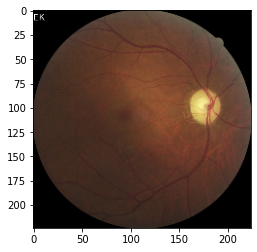

In [14]:
plt.imshow(cv2.cvtColor(np.array(testset.dataset[0]).astype('uint8'), cv2.COLOR_BGR2RGB))

In [15]:
import torchvision.transforms as T

In [16]:
trainset.labelset.shape

(47986, 1)

In [17]:
testset.labelset.shape

(5332, 1)

In [18]:
for idx in range(11):
    aa = np.sum(trainset.labelset == idx) + np.sum(testset.labelset == idx)
    print(f'idx = {idx} and number of data {aa}')

idx = 0 and number of data 1760
idx = 1 and number of data 1153
idx = 2 and number of data 1711
idx = 3 and number of data 2175
idx = 4 and number of data 2061
idx = 5 and number of data 3386
idx = 6 and number of data 3969
idx = 7 and number of data 4524
idx = 8 and number of data 4553
idx = 9 and number of data 6454
idx = 10 and number of data 21572


In [19]:
model.load_state_dict(torch.load("pretrain_models/model_res_18_classification_dict_200_new.pt", map_location=torch.device('cpu')))


<All keys matched successfully>

In [20]:
model.eval()

Sequential(
  (0): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_runnin

In [21]:
def test_loop(dataloader, model):
    size = len(dataloader.dataset)
    num_batches = len(dataloader)
    test_loss, correct = 0, 0

    tot_class = np.zeros((4, 1))+0.001
    cor_class = np.zeros((4, 1))
    
    tot_est = np.array([])
    tot_label = np.array([])
    tot_pred = np.array([])
    
    
    with torch.no_grad():
        for batch, (X, y) in enumerate(dataloader):
            pred = np.array(model(X))
            
            tot_est = np.append(tot_est, pred.argmax(1))
            tot_label = np.append(tot_label, np.array(y))
            if tot_pred.shape[0] == 0:
                tot_pred = pred
            else:
                tot_pred = np.vstack((tot_pred, np.array(pred)))
            
            print("tot_pred shape", tot_pred.shape)

            
    return np.array(tot_est), np.array(tot_label), np.array(tot_pred)

In [22]:
tot_est, tot_label, tot_pred = test_loop(test_data_loader, model)

tot_pred shape (64, 11)
tot_pred shape (128, 11)
tot_pred shape (192, 11)
tot_pred shape (256, 11)
tot_pred shape (320, 11)
tot_pred shape (384, 11)
tot_pred shape (448, 11)
tot_pred shape (512, 11)
tot_pred shape (576, 11)
tot_pred shape (640, 11)
tot_pred shape (704, 11)
tot_pred shape (768, 11)
tot_pred shape (832, 11)
tot_pred shape (896, 11)
tot_pred shape (960, 11)
tot_pred shape (1024, 11)
tot_pred shape (1088, 11)
tot_pred shape (1152, 11)
tot_pred shape (1216, 11)
tot_pred shape (1280, 11)
tot_pred shape (1344, 11)
tot_pred shape (1408, 11)
tot_pred shape (1472, 11)
tot_pred shape (1536, 11)
tot_pred shape (1600, 11)
tot_pred shape (1664, 11)
tot_pred shape (1728, 11)
tot_pred shape (1792, 11)
tot_pred shape (1856, 11)
tot_pred shape (1920, 11)
tot_pred shape (1984, 11)
tot_pred shape (2048, 11)
tot_pred shape (2112, 11)
tot_pred shape (2176, 11)
tot_pred shape (2240, 11)
tot_pred shape (2304, 11)
tot_pred shape (2368, 11)
tot_pred shape (2432, 11)
tot_pred shape (2496, 11)
to

In [23]:
tot_est, tot_label, tot_pred

(array([3., 0., 1., ..., 0., 0., 0.]),
 array([0., 0., 0., ..., 0., 0., 0.]),
 array([[-2.378, -3.567,  1.371, ..., -3.846,  0.455,  3.361],
        [11.417, -1.138, -4.075, ..., -4.923, -3.008, -0.482],
        [ 3.875,  5.423, -3.331, ...,  0.815, -1.381, -0.074],
        ...,
        [ 8.777, -0.134, -4.894, ..., -1.575, -2.241, -0.69 ],
        [ 8.777, -0.134, -4.894, ..., -1.575, -2.241, -0.69 ],
        [ 8.777, -0.134, -4.894, ..., -1.575, -2.241, -0.69 ]],
       dtype=float32))

In [24]:
tot_prob = softmax(tot_pred)

In [25]:
class_np = np.arange(11)/10

In [26]:
rev_prob = np.sum(tot_prob * class_np, axis=1)

In [27]:
sns.set_style("dark")
sns.despine()
sns.set_context("paper")


<Figure size 432x288 with 0 Axes>

In [28]:
classes=[str(i/10) for i in range(11)] # 라벨 설정

cm = confusion_matrix(tot_label, tot_est)

In [29]:
cm

array([[ 132,   11,   10,    4,    2,    6,    5,    5,    0,    1,    4],
       [  13,   43,   25,   10,    5,    3,    3,    3,    6,    1,    3],
       [   2,   16,   63,   39,    7,   16,    8,    4,    2,    4,   10],
       [   4,    6,   48,   69,   23,   22,   19,   10,    5,    4,    7],
       [   6,    4,   12,   46,   46,   32,   16,    9,    7,    8,   20],
       [   3,    5,   17,   41,   33,   81,   46,   40,   15,   19,   38],
       [   1,    2,   16,   31,   19,   69,   73,   59,   32,   26,   68],
       [   2,    2,    7,   23,   19,   42,   71,   80,   44,   64,   98],
       [   0,    1,    2,    7,    9,   27,   38,   67,   77,   98,  129],
       [   0,    2,    3,    8,    4,   26,   31,   66,   75,  150,  280],
       [   1,    4,   10,   31,    9,   50,   46,   83,  108,  268, 1547]])

[[0.733 0.061 0.056 0.022 0.011 0.033 0.028 0.028 0.    0.006 0.022]
 [0.113 0.374 0.217 0.087 0.043 0.026 0.026 0.026 0.052 0.009 0.026]
 [0.012 0.094 0.368 0.228 0.041 0.094 0.047 0.023 0.012 0.023 0.058]
 [0.018 0.028 0.221 0.318 0.106 0.101 0.088 0.046 0.023 0.018 0.032]
 [0.029 0.019 0.058 0.223 0.223 0.155 0.078 0.044 0.034 0.039 0.097]
 [0.009 0.015 0.05  0.121 0.098 0.24  0.136 0.118 0.044 0.056 0.112]
 [0.003 0.005 0.04  0.078 0.048 0.174 0.184 0.149 0.081 0.066 0.172]
 [0.004 0.004 0.015 0.051 0.042 0.093 0.157 0.177 0.097 0.142 0.217]
 [0.    0.002 0.004 0.015 0.02  0.059 0.084 0.147 0.169 0.215 0.284]
 [0.    0.003 0.005 0.012 0.006 0.04  0.048 0.102 0.116 0.233 0.434]
 [0.    0.002 0.005 0.014 0.004 0.023 0.021 0.038 0.05  0.124 0.717]]


<AxesSubplot:xlabel='Predicted BCVA', ylabel='Actual BCVA'>

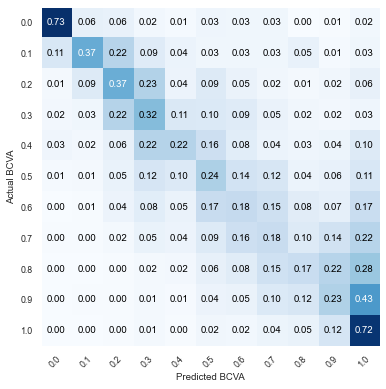

In [30]:
plot_confusion_matrix(tot_label, tot_est, classes, cmap=plt.cm.Blues)

In [31]:
def print_wrong_img(est, real, rev_pred, file_name,  NUM_CLASS = 11, NUM_SEL = 4):
    tot_val = real.shape[0]
    cursor = 0
    sel_idx = np.zeros((NUM_CLASS, NUM_SEL))
    sel_est = np.zeros((NUM_CLASS, NUM_SEL))
    sel_rev_pred = np.zeros((NUM_CLASS, NUM_SEL))

    for i in range(NUM_CLASS):
        idx = (np.abs(real - i) < 0.01 )
        ran_max = np.sum(idx)
        for j in range(NUM_SEL):
            rand_val = np.random.randint(ran_max)
            while ( np.abs(real[rand_val+cursor] - i) > 0.1 )  | ( np.abs(real[rand_val+cursor] - est[rand_val+cursor]) < 2.5 ) :
                rand_val = np.random.randint(ran_max)
            sel_idx[i, j] = rand_val+cursor
            sel_est[i, j] = est[rand_val+cursor]
            sel_rev_pred[i, j] = rev_pred[rand_val+cursor]

        cursor = cursor + ran_max

    VA_index = [str(i) for i in range(NUM_CLASS)]

    with h5py.File(file_name, 'r') as file:
        for i in range(1):
            print("VA value = ", VA_index[i])
            fig, ax = plt.subplots(1, 6, figsize=(30,10))
            for j in range(6):
                idx = sel_idx[2*j][0]
                est_val = sel_est[2*j][0]
                rev_pred_val = sel_rev_pred[2*j][0]
                ax[j].imshow(cv2.cvtColor(np.array(file["data"][idx]).astype('uint8'), cv2.COLOR_BGR2RGB))
                ax[j].set_title("Actual: " + '{:.1f}'.format(float(file["label"][idx])/10) + "  Prediction: " + '{:.1f}'.format(est_val/10.0)  , fontsize=25, weight='bold')
                ax[j].axis(False)
                fig.tight_layout()
            plt.savefig('RESNET_CLA_WRONG.eps', format='eps', dpi=300)
            plt.show()
            
            print("")
    return sel_idx, sel_est
    

VA value =  0


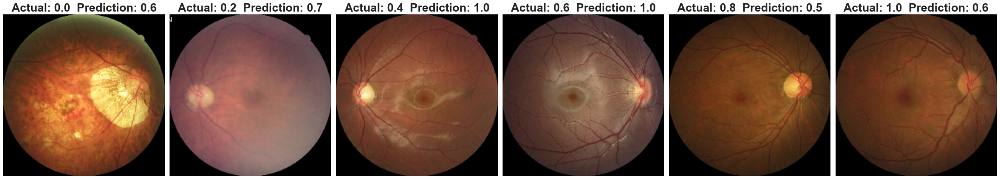

In [32]:
sel_idx, sel_est = print_wrong_img(tot_est, tot_label, rev_prob, 'data/test_224.h5')

In [32]:
def print_wrong_img_new(est, real, rev_pred, file_name,  NUM_CLASS = 11, NUM_SEL = 4):
    tot_val = real.shape[0]
    cursor = 0
    sel_idx = np.zeros((NUM_CLASS, NUM_SEL))
    sel_est = np.zeros((NUM_CLASS, NUM_SEL))
    sel_rev_pred = np.zeros((NUM_CLASS, NUM_SEL))

    idx_val_mat = [147, 350, 694, 1420, 2318, 5238]

    VA_index = [str(i) for i in range(NUM_CLASS)]

    with h5py.File(file_name, 'r') as file:
        for i in range(1):
            print("VA value = ", VA_index[i])
            fig, ax = plt.subplots(1, 6, figsize=(30,10))
            for j in range(6):
                idx = idx_val_mat[j]
                est_val = est[idx]
                rev_pred[idx]
                
                ax[j].imshow(cv2.cvtColor(np.array(file["data"][idx]).astype('uint8'), cv2.COLOR_BGR2RGB))
                ax[j].set_title("Actual: " + '{:.1f}'.format(float(file["label"][idx])/10) + "  Prediction: " + '{:.1f}'.format(est_val/10.0)  , fontsize=25, weight='bold')
                ax[j].axis(False)
                fig.tight_layout()
            plt.savefig('RESNET_CLA_WRONG.eps', format='eps', dpi=300)
            plt.show()
            
            print("")
    return sel_idx, sel_est
    

VA value =  0


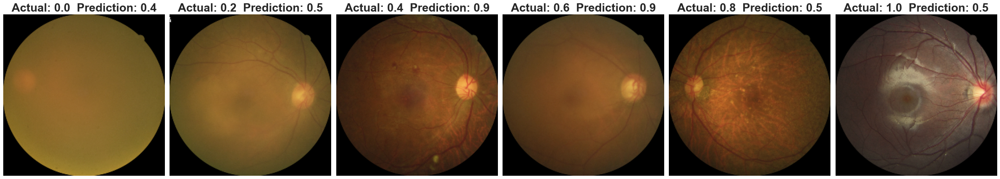

In [33]:
sel_idx, sel_est = print_wrong_img_new(tot_est, tot_label, rev_prob, 'data/test_224.h5')

In [33]:
def print_wrong_img_temp(est, real, rev_pred, file_name,  NUM_CLASS = 11, NUM_SEL = 10):
    tot_val = real.shape[0]
    cursor = 0
    sel_idx = np.zeros((NUM_CLASS, NUM_SEL))
    sel_est = np.zeros((NUM_CLASS, NUM_SEL))
    sel_rev_pred = np.zeros((NUM_CLASS, NUM_SEL))

    for i in range(NUM_CLASS):
        idx = (np.abs(real - i) < 0.01 )
        ran_max = np.sum(idx)
        for j in range(NUM_SEL):
            rand_val = np.random.randint(ran_max)
            while ( np.abs(real[rand_val+cursor] - i) > 0.1 )  | ( np.abs(real[rand_val+cursor] - est[rand_val+cursor]) < 2.5 ) :
                rand_val = np.random.randint(ran_max)
            sel_idx[i, j] = rand_val+cursor
            sel_est[i, j] = est[rand_val+cursor]
            sel_rev_pred[i, j] = rev_pred[rand_val+cursor]

        cursor = cursor + ran_max

    VA_index = [str(i) for i in range(NUM_CLASS)]


    with h5py.File(file_name, 'r') as file:
        for i in range(6):
            print("VA value = ", VA_index[i])
            fig, ax = plt.subplots(2, 5, figsize=(30,20))
            for j in range(10):
                idx = sel_idx[2*i][j]
                est_val = sel_est[2*i][j]
                rev_pred_val = sel_rev_pred[2*i][j]
                ax[j%2, j//2].imshow(cv2.cvtColor(np.array(file["data"][idx]).astype('uint8'), cv2.COLOR_BGR2RGB))
                ax[j%2, j//2].set_title("IDX: " + '{:.0f}'.format(idx) + "  Actual: " + '{:.1f}'.format(float(file["label"][idx])/10) + "  Prediction: " + '{:.1f}'.format(est_val/10.0)  , fontsize=25, weight='bold')
                ax[j%2, j//2].axis(False)
                fig.tight_layout()
            plt.show()
            
            print("")
    return sel_idx, sel_est
    

VA value =  0


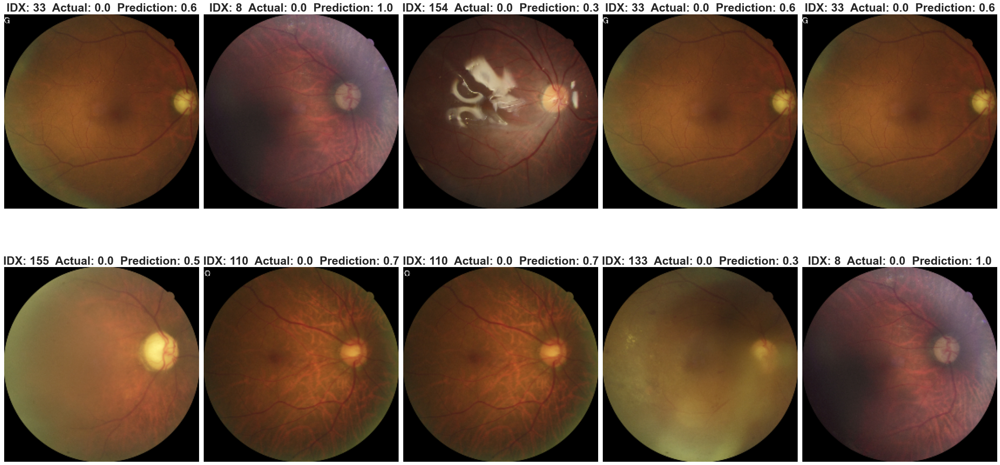


VA value =  1


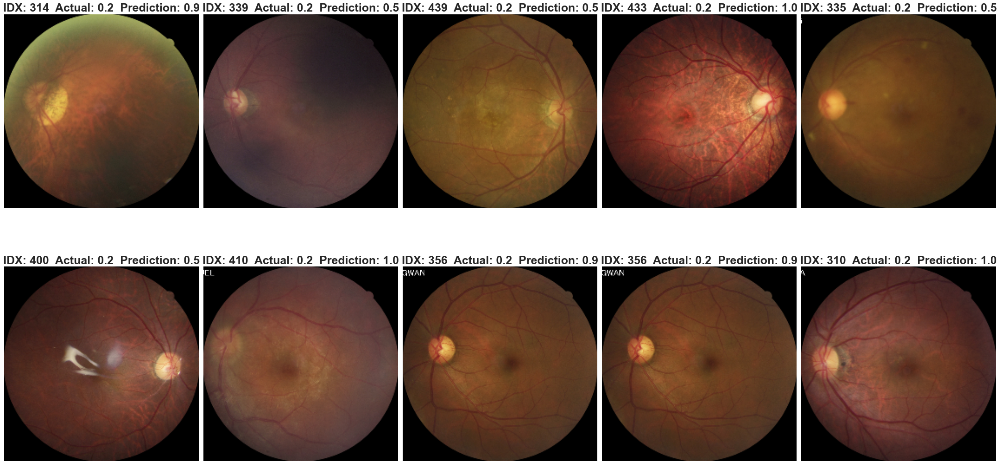


VA value =  2


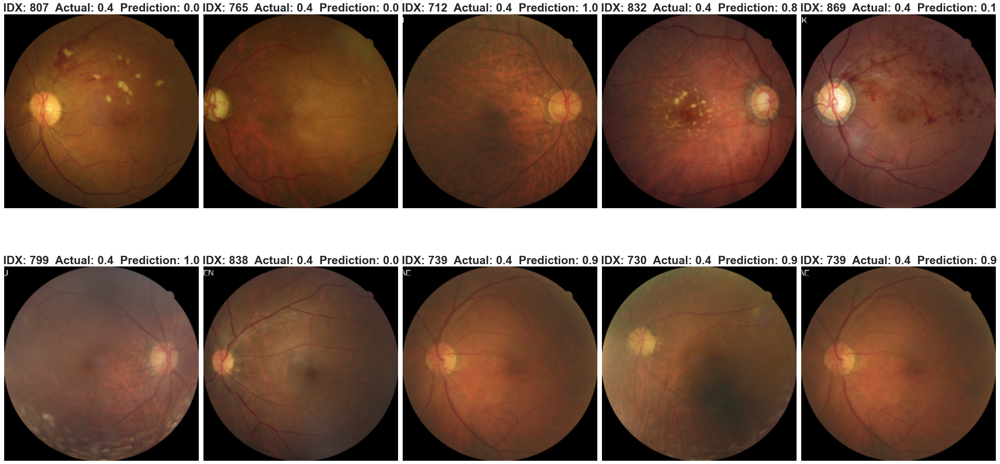


VA value =  3


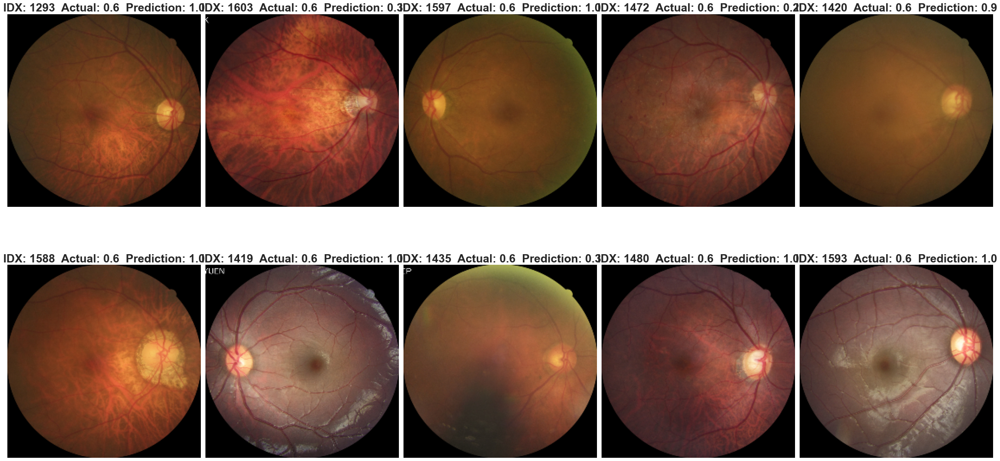


VA value =  4


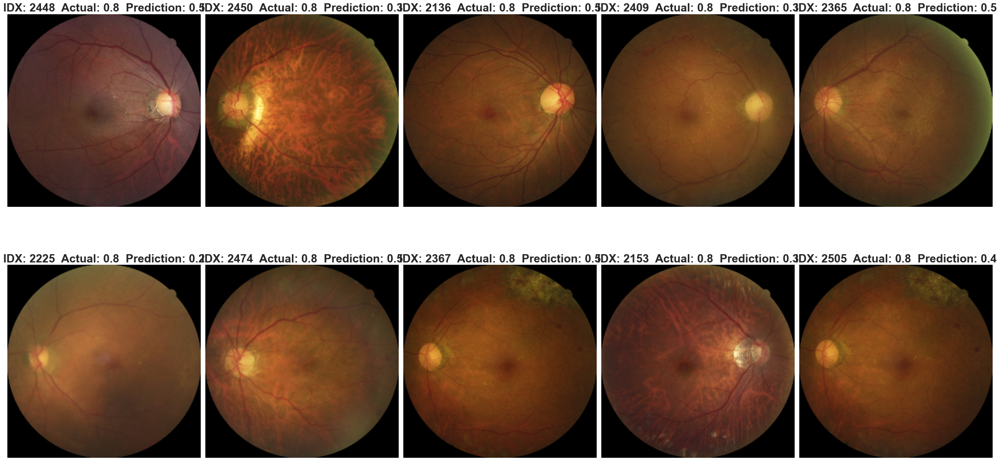


VA value =  5


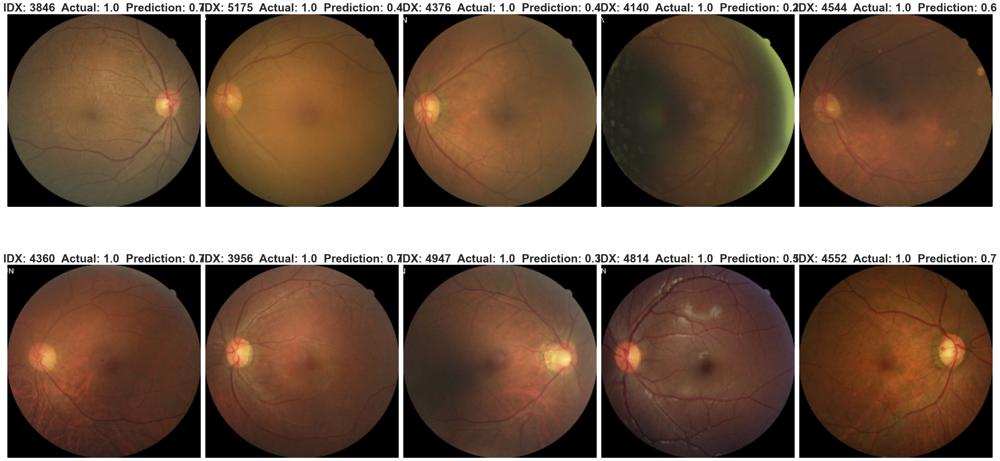

In [34]:
sel_idx, sel_est = print_wrong_img_temp(tot_est, tot_label, rev_prob, 'data/test_224.h5')

In [35]:
def print_wrong_img_short(est, real, rev_pred, file_name,  NUM_CLASS = 11, NUM_SEL = 12, start = 0):
    tot_val = real.shape[0]
    cursor = 0
    sel_idx = np.zeros((NUM_CLASS, NUM_SEL))
    sel_est = np.zeros((NUM_CLASS, NUM_SEL))
    sel_rev_pred = np.zeros((NUM_CLASS, NUM_SEL))

    for i in range(NUM_CLASS):
        idx = (real == i)
        ran_max = np.sum(idx)

        for j in range(NUM_SEL):
            rand_val = np.random.randint(ran_max)
            while (real[rand_val+cursor] != i) | (real[rand_val+cursor] == est[rand_val+cursor]):
                rand_val = np.random.randint(ran_max)
            sel_idx[i, j] = rand_val+cursor
            sel_est[i, j] = est[rand_val+cursor]
            sel_rev_pred[i, j] = rev_pred[rand_val+cursor]

        cursor = cursor + ran_max

    VA_index = [str(i) for i in range(NUM_CLASS)]

    with h5py.File(file_name, 'r') as file:
        for ii in range(1):
            i = ii + start
            print("VA value = ", VA_index[i])
            fig, ax = plt.subplots(3, 3, figsize=(25,25))
            for j in range(NUM_SEL):
                idx = sel_idx[i][j]
                est_val = sel_est[i][j]
                rev_pred_val = sel_rev_pred[i][j]
                ax[j//3, j%3].imshow(cv2.cvtColor(np.array(file["data"][idx]).astype('uint8'), cv2.COLOR_BGR2RGB))
                ax[j//3, j%3].set_title("Estimation: " + ' {:.2f}'.format(rev_pred_val) +",  Actual: " + ' {:.1f}'.format(float(file["label"][idx])/10)  , fontsize=20)
                ax[j//3, j%3].axis(False)
                fig.tight_layout()
            plt.show()
            print("")
    return sel_idx, sel_est
    

In [36]:
sns.set_style("dark")
sns.despine()
sns.set_context("paper")

<Figure size 432x288 with 0 Axes>

VA value =  0


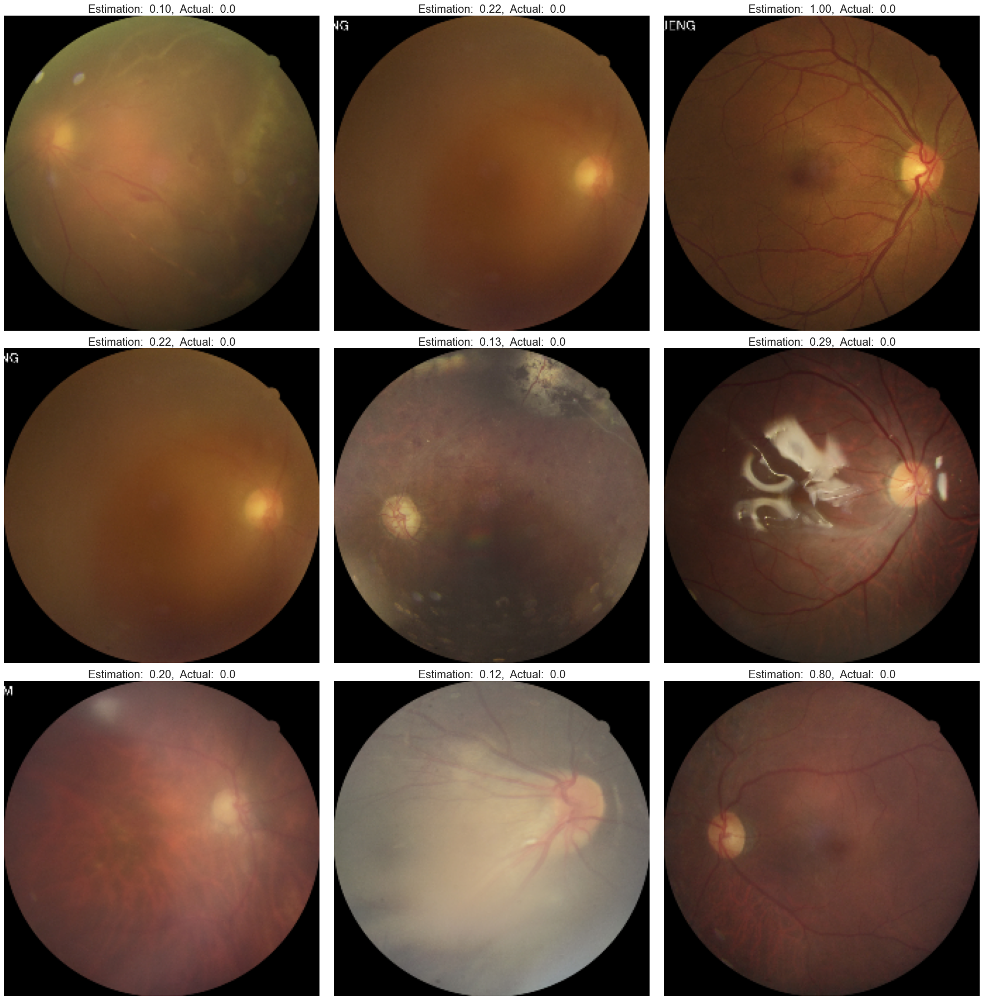

In [37]:
sel_idx, sel_est = print_wrong_img_short(tot_est, tot_label, rev_prob, 'data/test_224.h5',  NUM_CLASS = 11, NUM_SEL = 9, start = 0)



VA value =  1


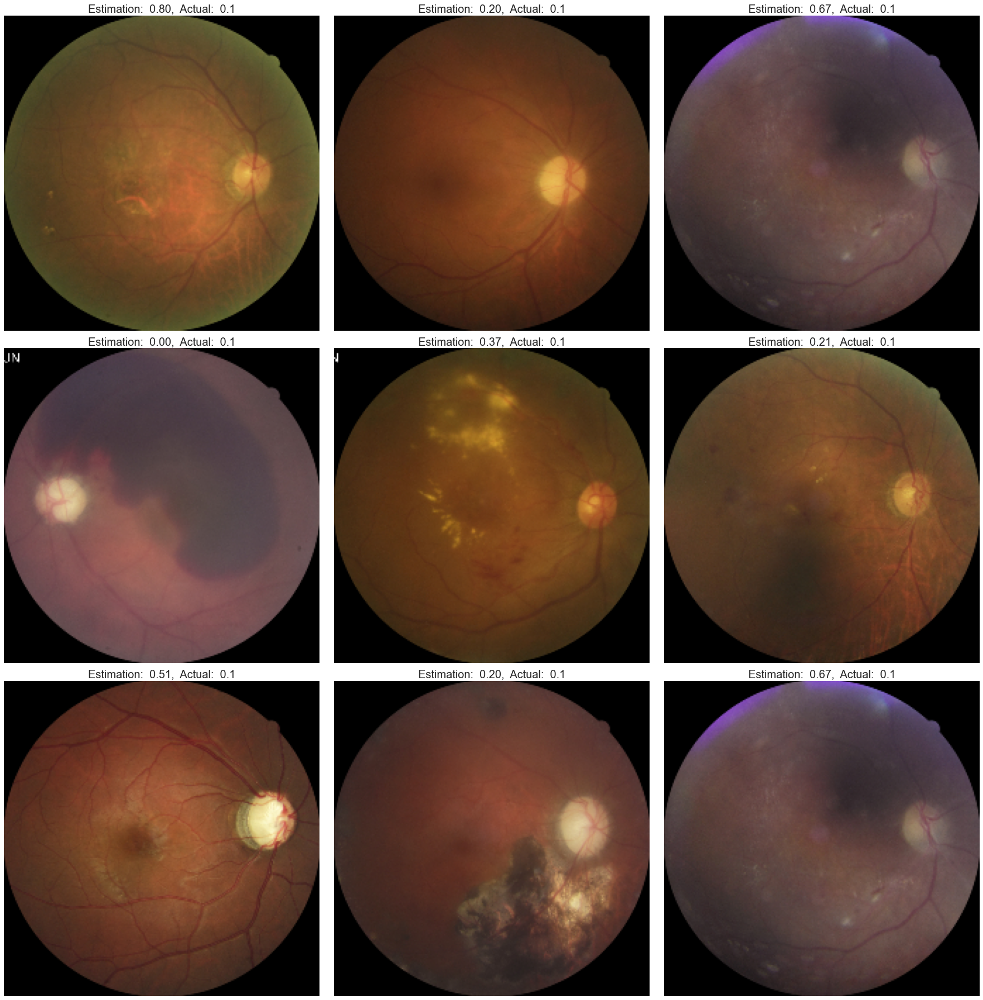

In [38]:
sel_idx, sel_est = print_wrong_img_short(tot_est, tot_label, rev_prob, 'data/test_224.h5',  NUM_CLASS = 11, NUM_SEL = 9, start = 1)


VA value =  2


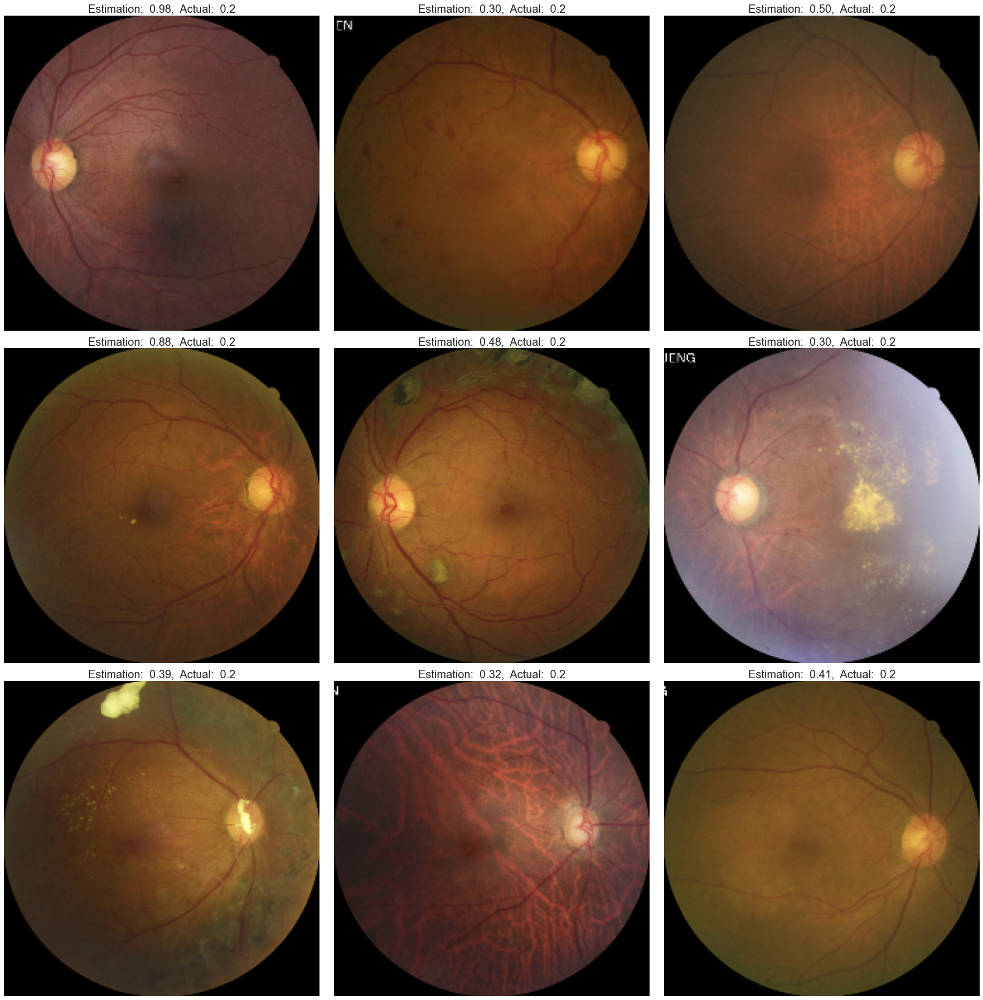

In [39]:
sel_idx, sel_est = print_wrong_img_short(tot_est, tot_label, rev_prob, 'data/test_224.h5',  NUM_CLASS = 11, NUM_SEL = 9, start = 2)


VA value =  3


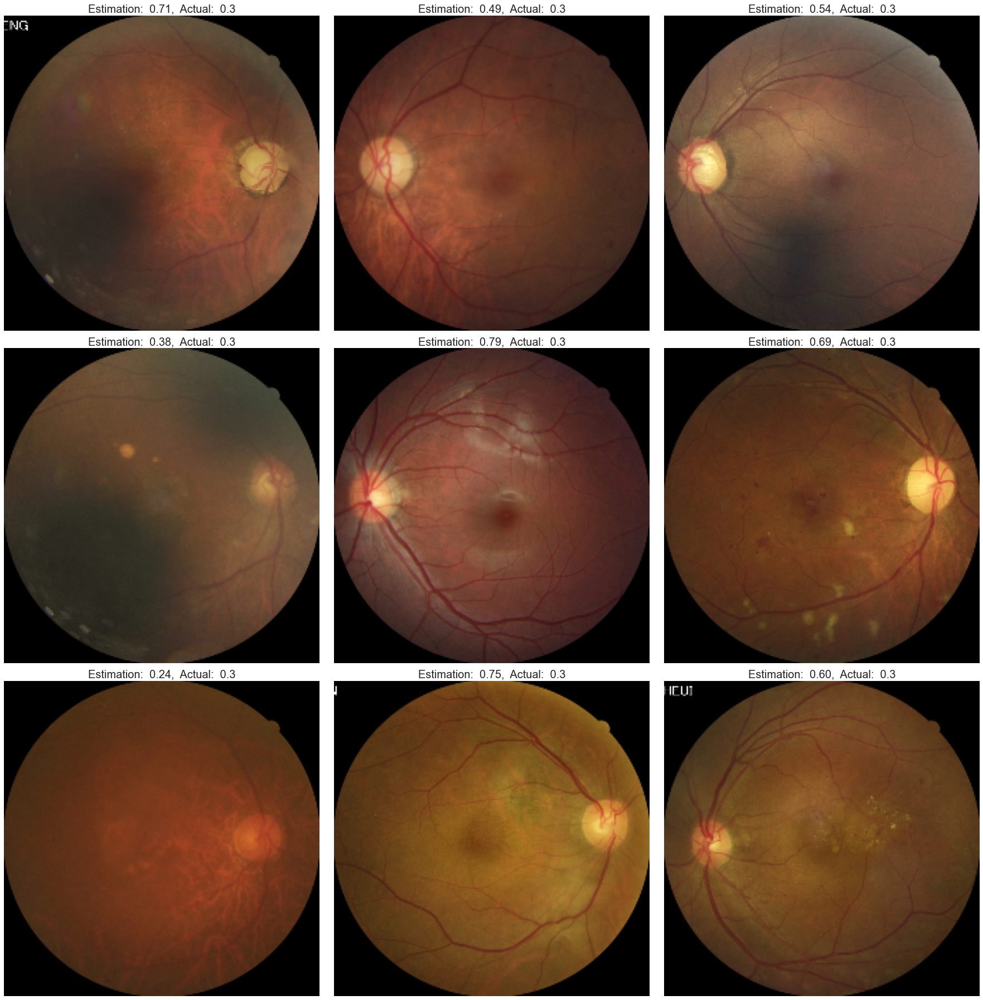

In [40]:
sel_idx, sel_est = print_wrong_img_short(tot_est, tot_label, rev_prob, 'data/test_224.h5',  NUM_CLASS = 11, NUM_SEL = 9, start = 3)


VA value =  4


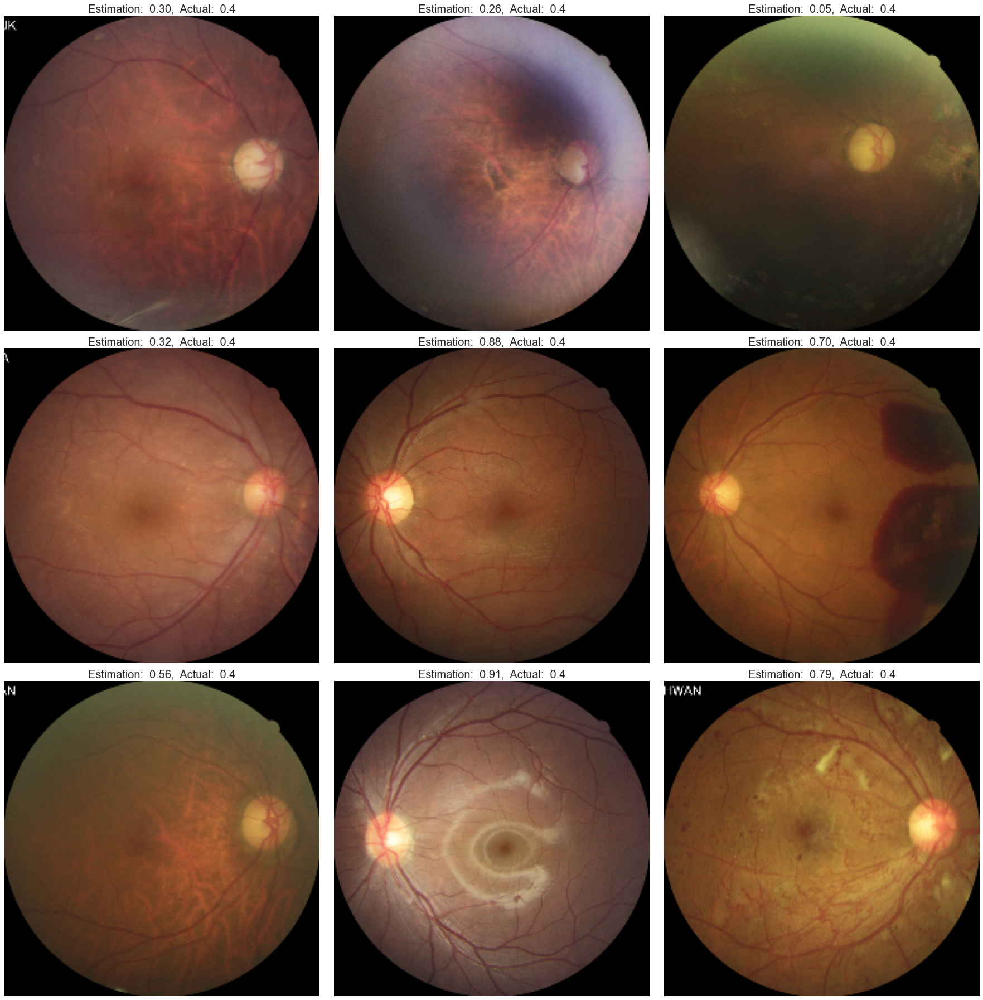

In [41]:
sel_idx, sel_est = print_wrong_img_short(tot_est, tot_label, rev_prob, 'data/test_224.h5',  NUM_CLASS = 11, NUM_SEL = 9, start = 4)


VA value =  5


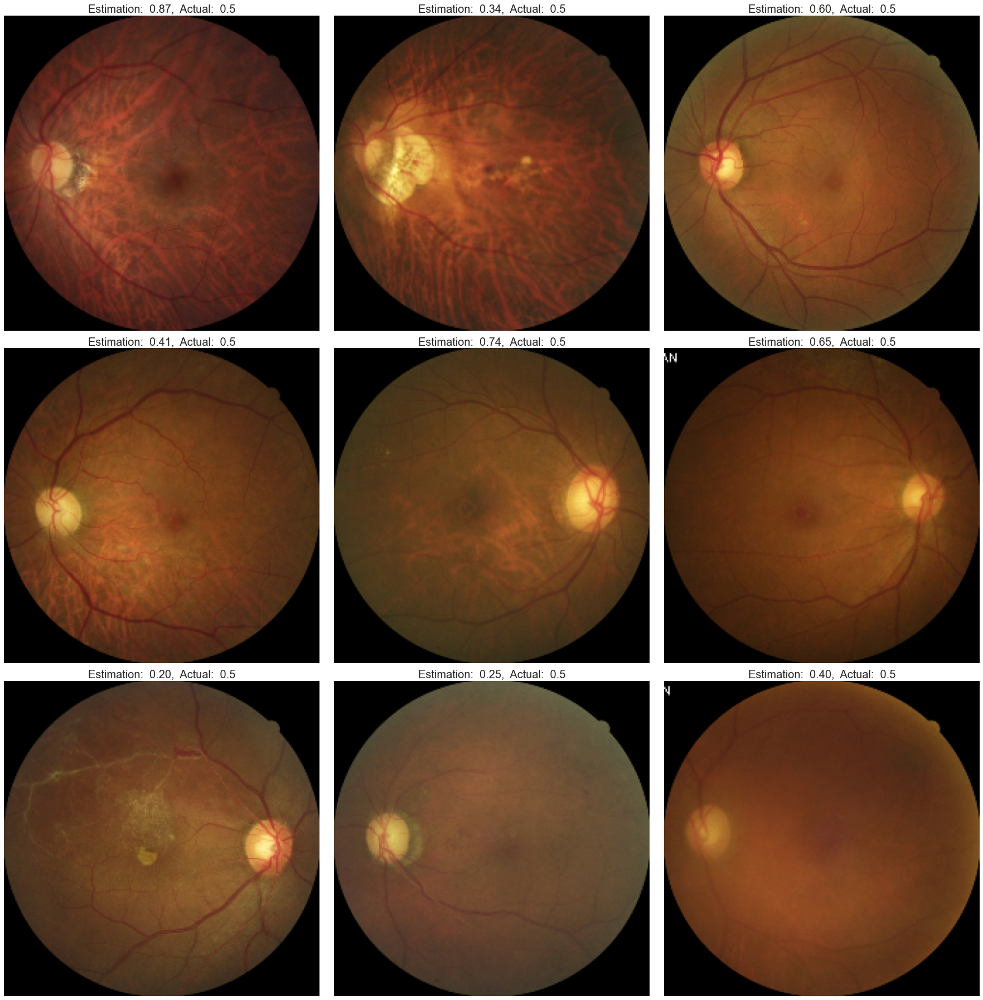

In [42]:
sel_idx, sel_est = print_wrong_img_short(tot_est, tot_label, rev_prob, 'data/test_224.h5',  NUM_CLASS = 11, NUM_SEL = 9, start = 5)


VA value =  6


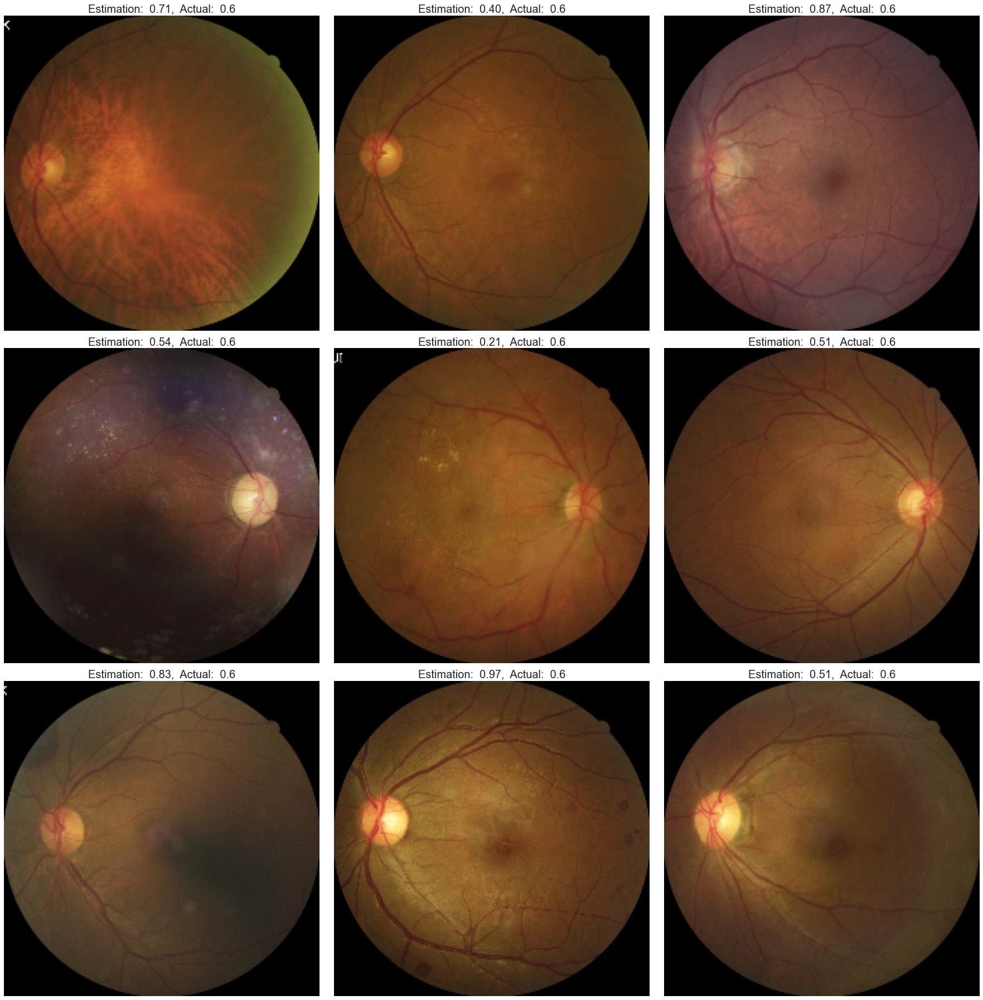

In [43]:
sel_idx, sel_est = print_wrong_img_short(tot_est, tot_label, rev_prob, 'data/test_224.h5',  NUM_CLASS = 11, NUM_SEL = 9, start = 6)


VA value =  7


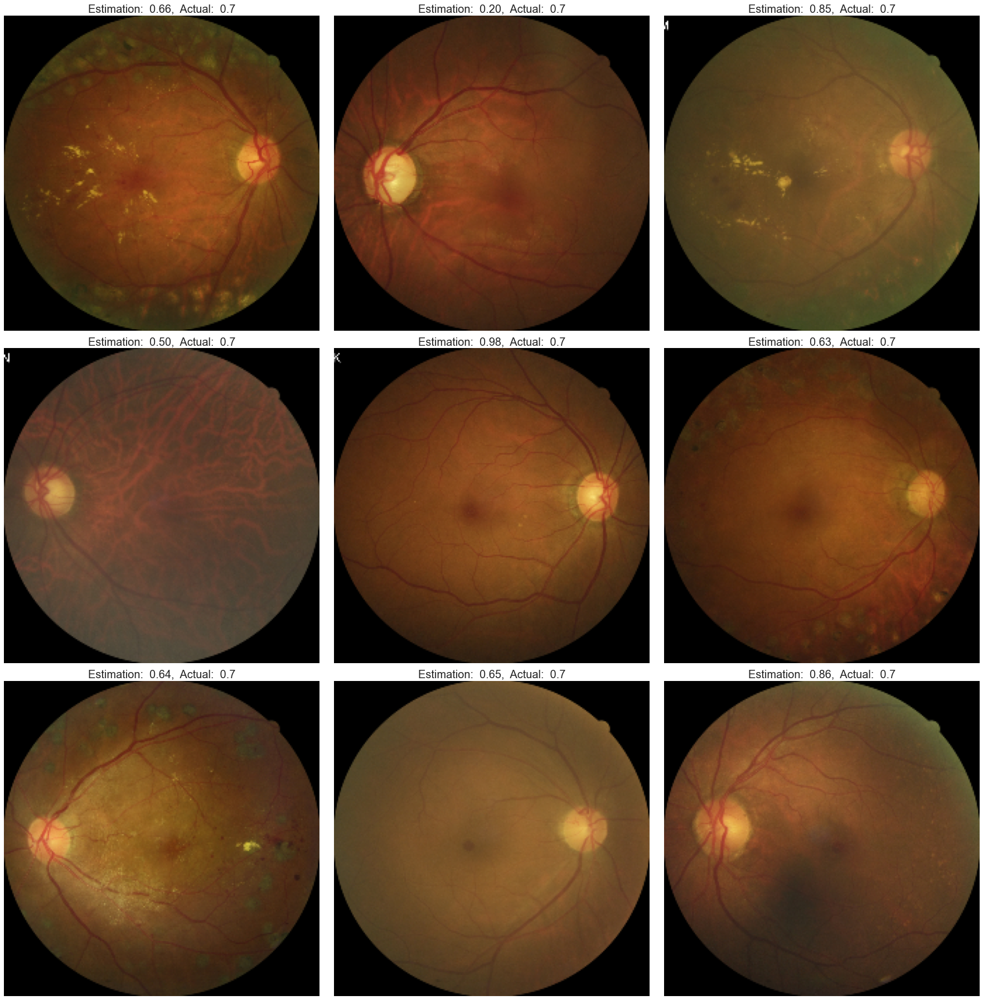

In [44]:
sel_idx, sel_est = print_wrong_img_short(tot_est, tot_label, rev_prob, 'data/test_224.h5',  NUM_CLASS = 11, NUM_SEL = 9, start = 7)


VA value =  8


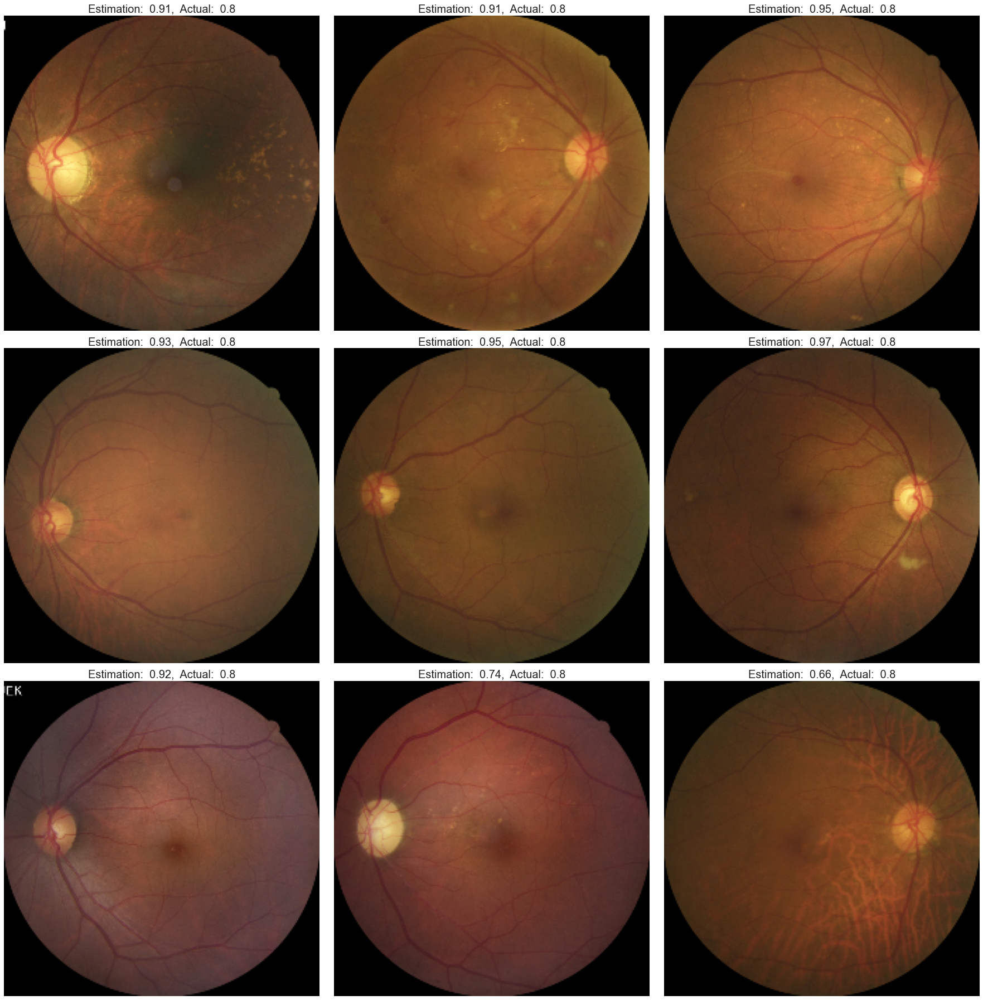

In [45]:
sel_idx, sel_est = print_wrong_img_short(tot_est, tot_label, rev_prob, 'data/test_224.h5',  NUM_CLASS = 11, NUM_SEL = 9, start = 8)


VA value =  9


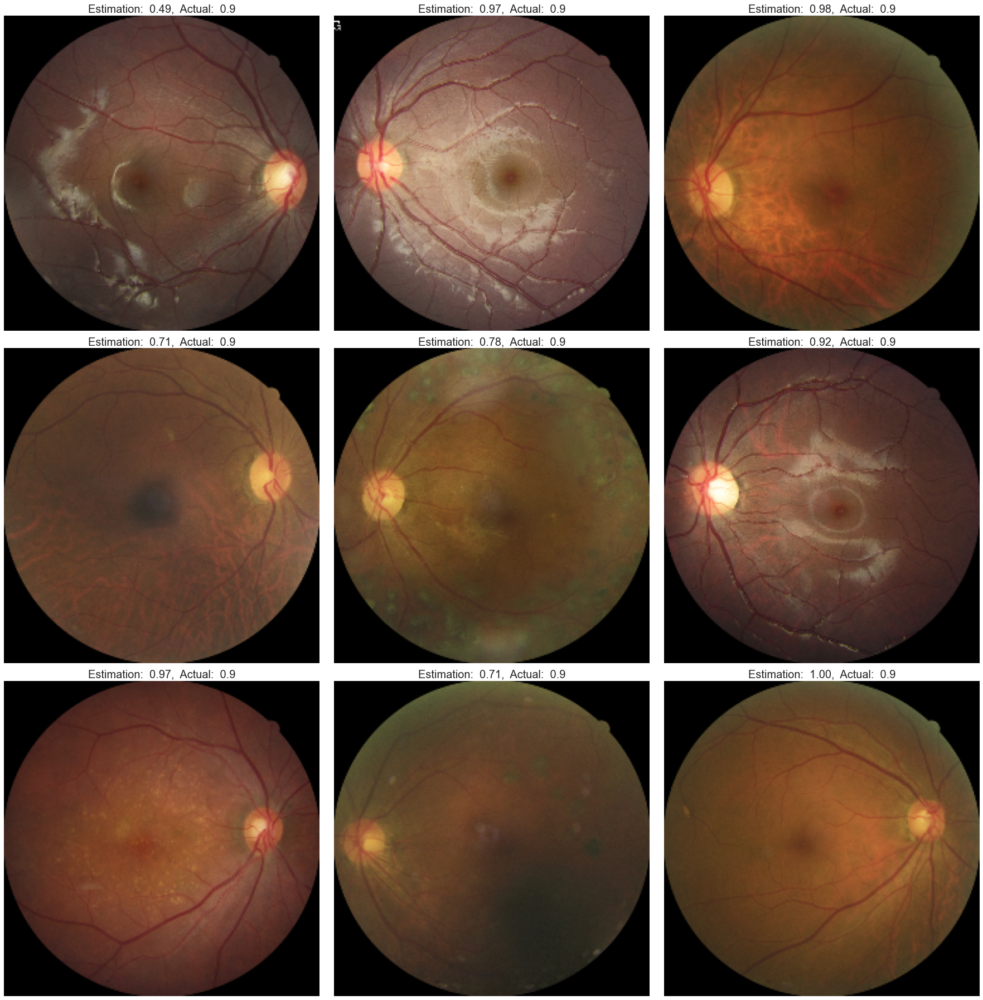

In [46]:
sel_idx, sel_est = print_wrong_img_short(tot_est, tot_label, rev_prob, 'data/test_224.h5',  NUM_CLASS = 11, NUM_SEL = 9, start = 9)


VA value =  10


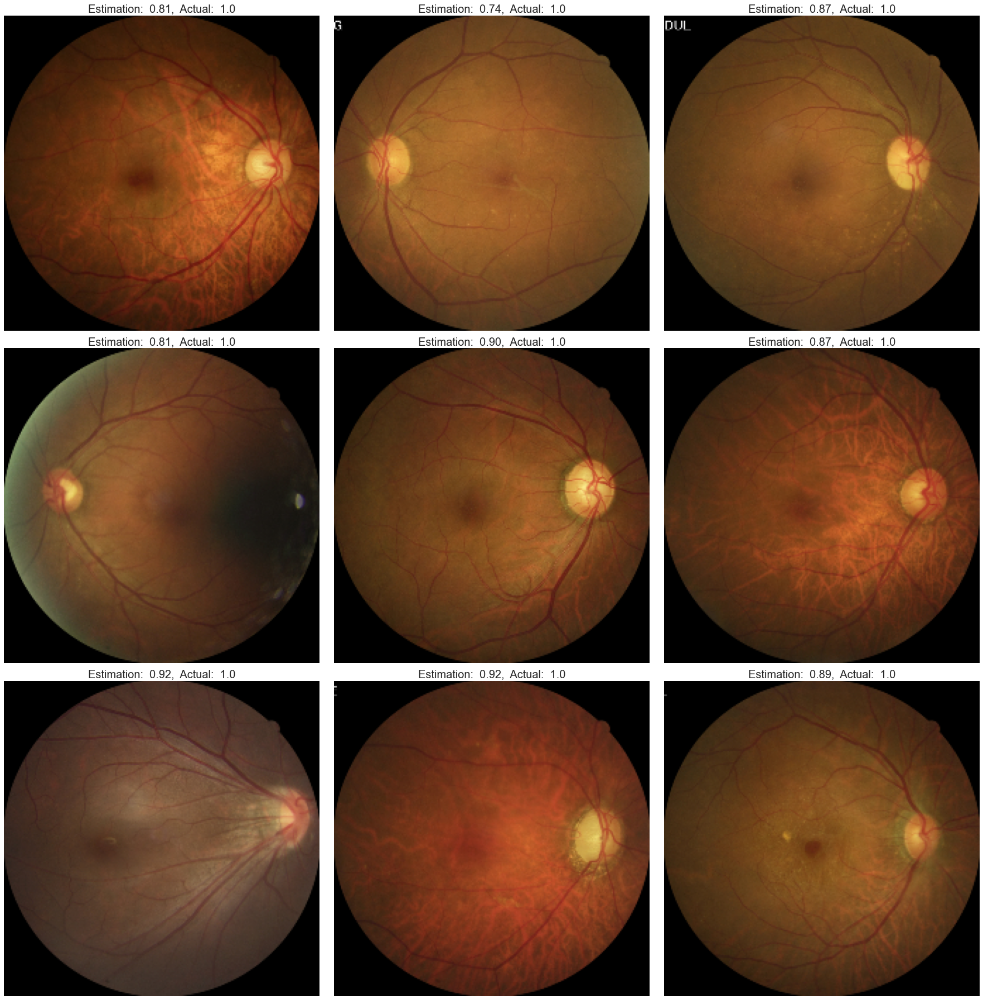

In [47]:
sel_idx, sel_est = print_wrong_img_short(tot_est, tot_label, rev_prob, 'data/test_224.h5',  NUM_CLASS = 11, NUM_SEL = 9, start = 10)


In [63]:
def print_his_img(est, real, NUM_CLASS = 11):
    tot_val = real.shape[0]
    cursor = 0
    
    fig, ax = plt.subplots(3, 4, figsize=(9,5))
    
    for i in range(NUM_CLASS):
        idx = (np.abs(real - i) < 0.01 )
        list_find = []
        aa = 0
        for j in range(tot_val):
            if idx[j] == True:
                list_find.append(est[j])
                aa += 1
        
        print("i = ", i, "aa = ", aa)
        list_find = np.array(list_find)
        ax[i//4, i%4].hist(list_find, bins=11)
        ax[i//4, i%4].set_title("BCVA = " + str(i/10), y=1.0, pad=1.5, weight='bold')
        ax[i//4, i%4].set_xticks([])
        ax[i//4, i%4].set_yticks([])
    
    #ax[2, 3].hist(est, bins=11, color='r', alpha=0.5, label='Est.')
    #ax[2, 3].hist(real/10, bins=11, color='g', alpha=0.5, label='Real.')
    ax[2, 3].hist((est, real/10.0), bins=11, histtype='bar', label=('Prediction', 'Actual'))
    
    ax[2, 3].set_title("Total BCVA", y=1.0, pad=1.5, weight='bold')
    ax[2, 3].legend(loc='upper left')
    ax[2, 3].set_yticks([])
    plt.savefig('RESNET_CLA_HIST.eps', format='eps', dpi=300)
        

i =  0 aa =  180
i =  1 aa =  115
i =  2 aa =  171
i =  3 aa =  217
i =  4 aa =  206
i =  5 aa =  338
i =  6 aa =  396
i =  7 aa =  452
i =  8 aa =  455
i =  9 aa =  645
i =  10 aa =  2157


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


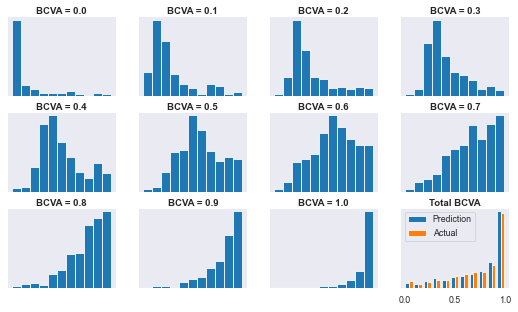

In [64]:
print_his_img(rev_prob, tot_label, NUM_CLASS = 11)


In [50]:
print_soft_accu(rev_prob, tot_label, NUM_CLASS = 11, tor_lev = 0)

i =  0 cor_num =  99 tot_num =  180 ratio =  55.0
i =  1 cor_num =  27 tot_num =  115 ratio =  23.47826086956522
i =  2 cor_num =  38 tot_num =  171 ratio =  22.22222222222222
i =  3 cor_num =  36 tot_num =  217 ratio =  16.589861751152075
i =  4 cor_num =  17 tot_num =  206 ratio =  8.25242718446602
i =  5 cor_num =  22 tot_num =  338 ratio =  6.508875739644971
i =  6 cor_num =  17 tot_num =  396 ratio =  4.292929292929293
i =  7 cor_num =  11 tot_num =  452 ratio =  2.433628318584071
i =  8 cor_num =  15 tot_num =  455 ratio =  3.2967032967032965
i =  9 cor_num =  31 tot_num =  645 ratio =  4.8062015503875966
i =  10 cor_num =  508 tot_num =  2157 ratio =  23.55122855818266

tot prob =  15.397599399849963


In [51]:
print_soft_accu(rev_prob, tot_label, NUM_CLASS = 11, tor_lev = 1)

i =  0 cor_num =  133 tot_num =  180 ratio =  73.88888888888889
i =  1 cor_num =  69 tot_num =  115 ratio =  60.0
i =  2 cor_num =  100 tot_num =  171 ratio =  58.47953216374269
i =  3 cor_num =  128 tot_num =  217 ratio =  58.986175115207374
i =  4 cor_num =  97 tot_num =  206 ratio =  47.0873786407767
i =  5 cor_num =  137 tot_num =  338 ratio =  40.532544378698226
i =  6 cor_num =  157 tot_num =  396 ratio =  39.64646464646464
i =  7 cor_num =  163 tot_num =  452 ratio =  36.06194690265487
i =  8 cor_num =  220 tot_num =  455 ratio =  48.35164835164835
i =  9 cor_num =  487 tot_num =  645 ratio =  75.50387596899225
i =  10 cor_num =  1632 tot_num =  2157 ratio =  75.6606397774687

tot prob =  62.3218304576144


In [52]:
print_soft_accu(rev_prob, tot_label, NUM_CLASS = 11, tor_lev = 2)

i =  0 cor_num =  145 tot_num =  180 ratio =  80.55555555555556
i =  1 cor_num =  82 tot_num =  115 ratio =  71.30434782608695
i =  2 cor_num =  122 tot_num =  171 ratio =  71.34502923976608
i =  3 cor_num =  160 tot_num =  217 ratio =  73.73271889400921
i =  4 cor_num =  147 tot_num =  206 ratio =  71.35922330097087
i =  5 cor_num =  213 tot_num =  338 ratio =  63.01775147928994
i =  6 cor_num =  249 tot_num =  396 ratio =  62.878787878787875
i =  7 cor_num =  296 tot_num =  452 ratio =  65.48672566371681
i =  8 cor_num =  413 tot_num =  455 ratio =  90.76923076923077
i =  9 cor_num =  565 tot_num =  645 ratio =  87.59689922480621
i =  10 cor_num =  1898 tot_num =  2157 ratio =  87.9925822902179

tot prob =  80.4576144036009


In [53]:
print_soft_accu(rev_prob, tot_label, NUM_CLASS = 11, tor_lev = 3)

i =  0 cor_num =  154 tot_num =  180 ratio =  85.55555555555556
i =  1 cor_num =  94 tot_num =  115 ratio =  81.73913043478261
i =  2 cor_num =  137 tot_num =  171 ratio =  80.11695906432749
i =  3 cor_num =  182 tot_num =  217 ratio =  83.87096774193549
i =  4 cor_num =  167 tot_num =  206 ratio =  81.06796116504854
i =  5 cor_num =  268 tot_num =  338 ratio =  79.28994082840237
i =  6 cor_num =  337 tot_num =  396 ratio =  85.1010101010101
i =  7 cor_num =  426 tot_num =  452 ratio =  94.24778761061947
i =  8 cor_num =  439 tot_num =  455 ratio =  96.48351648351648
i =  9 cor_num =  604 tot_num =  645 ratio =  93.64341085271317
i =  10 cor_num =  2025 tot_num =  2157 ratio =  93.88038942976355

tot prob =  90.64141035258815


In [54]:
tot_label[-100:]

array([10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10.,
       10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10.,
       10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10.,
       10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10.,
       10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10.,
       10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10., 10.,
       10., 10., 10., 10.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
        0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.])

In [55]:
def new_classification_report(y_true, y_pred, NUM_CLASS = 11, tor_lev = 3):
    tot_val = y_true.shape[0]
    cor_num_tot = 0
    tot_accu = 0

    for i in range(NUM_CLASS):
        idx = (np.abs(y_true - i) < 0.01 )
        list_find = []
        cor_num = 0
        tot_num = np.sum(idx)
        
        TP, FN, TN, FP, support = 0, 0, 0, 0, 0
        for j in range(tot_val):
            if idx[j] == True:
                support +=  1
                if (np.abs(i/10.0 - y_pred[j]/10.0) <= (tor_lev+0.5)/10.0):   
                    TP += 1
                    tot_accu += 1
                else:
                    FN += 1                    
            else:
                if (np.abs(i/10.0 - y_pred[j]/10.0) <= (tor_lev+0.5)/10.0 ):
                    FP += 1
                else:
                    TN += 1
        
        Accu = (TP + TN)/(TP + TN + FP + FN)
        Recal = TP / (TP + FN)
        Prec = TP / (TP + FP)
        
        #print("VA i = ", i)
        #print(f'Support : {support:.2f}')
        #print(f'Accuracy : {Accu:.2f}, Recall : {Recal:.2f} Precision : {Prec:.2f}, F1-score : {2*Recal*Prec/(Recal+ Prec):.2f}')
        #print("")
        
    print(f'Tot accuracy : {100*tot_accu/tot_val:.3f}')
    
    

In [56]:
new_classification_report(tot_label, tot_est, NUM_CLASS = 11, tor_lev = 0)

Tot accuracy : 44.280


In [57]:
new_classification_report(tot_label, tot_est, NUM_CLASS = 11, tor_lev = 1)

Tot accuracy : 69.842


In [58]:
new_classification_report(tot_label, tot_est, NUM_CLASS = 11, tor_lev = 2)

Tot accuracy : 82.296


In [59]:
new_classification_report(tot_label, tot_est, NUM_CLASS = 11, tor_lev = 3)

Tot accuracy : 89.947


In [60]:
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

In [61]:
mean_squared_error(tot_label/10.0, tot_est/10.0)

0.042406226556639164

In [62]:
r2_score(tot_label, tot_est)

0.5000933184886771